In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from scipy.stats import skew, kurtosis


In [1]:
len(['voltage', 'reactive_power', 'power_factor', 
                                    'temp', 'feels_like', 'temp_min', 'temp_max', 'pressure', 'humidity',
                                    'speed', 'deg', 'active_power_lag_1', 'active_power_lag_8', 'year',
                                    'month_of_year', 'week_of_year', 'day_of_year', 'day_of_week', 'hour_of_day', 
                                    'is_weekend', 'is_holiday', 'main_Clouds', 'main_Drizzle', 'main_Fog',
                                    'main_Haze', 'main_Mist', 'main_Rain', 'main_Thunderstorm', 
                                    'description_clear sky', 'description_drizzle', 'description_few clouds', 
                                    'description_fog', 'description_haze', 'description_heavy intensity rain', 
                                    'description_light intensity drizzle', 'description_light rain',
                                    'description_mist', 'description_moderate rain', 'description_overcast clouds',
                                    'description_scattered clouds', 'description_thunderstorm',
                                    'description_thunderstorm with rain', 'description_very heavy rain',
                                    'temp_mean_window_24', 'temp_std_window_24', 
                                    'feels_like_mean_window_24', 'feels_like_std_window_24']  )

47

# EDA steps:

1. general data information : type of the problem , number of columns and description, shape of the table(s)

2. descriptive statistics per feature

3. Describing distribution

4. feature visualisation 

5. Inferential Statistics

In [2]:
data = pd.read_csv("../data/raw/data.csv")

In [3]:
data.head()

,date,active_power,current,voltage,reactive_power,apparent_power,power_factor,main,description,temp,feels_like,temp_min,temp_max,pressure,humidity,speed,deg,temp_t+1,feels_like_t+1
0,2022-11-05 14:05:00,265.1,2.53,122.2,159.09,309.17,0.8575,Clear,clear sky,24.19,23.68,23.44,27.5,1013,39,0.0,0,29.63,27.97
1,2022-11-05 14:06:00,265.1,2.53,122.2,159.09,309.17,0.8575,Clear,clear sky,24.19,23.68,23.44,27.5,1013,39,0.0,0,29.63,27.97
2,2022-11-05 14:07:00,265.1,2.53,122.2,159.09,309.17,0.8575,Clear,clear sky,24.19,23.68,23.44,27.5,1013,39,0.0,0,29.63,27.97
3,2022-11-05 14:08:00,640.0,5.45,120.7,152.08,657.82,0.9729,Clear,clear sky,24.19,23.68,23.44,27.5,1013,39,0.0,0,29.63,27.97
4,2022-11-05 14:09:00,257.6,2.47,122.4,158.26,302.33,0.8520,Clear,clear sky,24.19,23.68,23.44,27.5,1013,39,0.0,0,29.63,27.97


In [4]:
data.active_power.isna().sum()

0

In [5]:
def features_description(data):
      features_description = []
      
      for column in data.columns:
            col_data = data[column]
            col_summary = {}
            
            col_summary['Column'] = column
            col_summary['Type'] = col_data.dtype
            
            if np.issubdtype(col_data.dtype, np.number):
                  col_summary['Mean'] = col_data.mean()
                  col_summary['Median'] = col_data.median()
                  col_summary['Std Dev'] = col_data.std()
                  col_summary['Variance'] = col_data.var()
                  
                  col_summary['Skewness'] = skew(col_data.dropna())
                  col_summary['Kurtosis'] = kurtosis(col_data.dropna())
            elif  np.issubsctype(col_data.dtype, pd.CategoricalDtype):
                  col_summary['Unique Values'] = col_data.nunique()
                  col_summary['Frequency'] = col_data.value_counts().to_dict()
                  
            col_summary['Null Values'] = col_data.isnull().sum()
            features_description.append(col_summary)
      
      return pd.DataFrame(features_description)

In [6]:
features_description(data.drop('date',1))

/tmp/ipykernel_17287/3554083536.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  features_description(data.drop('date',1))


,Column,Type,Mean,Median,Std Dev,Variance,Skewness,Kurtosis,Null Values,Unique Values,Frequency
0,active_power,float64,286.019377,250.3000,189.545683,35927.565884,2.107039,9.132029,0,NaN,NaN
1,current,float64,2.587303,2.2900,1.591395,2.532537,2.424986,12.264699,0,NaN,NaN
2,voltage,float64,125.417300,124.4000,4.390612,19.277471,0.315267,-0.724425,0,NaN,NaN
3,reactive_power,float64,132.538007,128.5000,71.030254,5045.296949,2.660551,20.121567,0,NaN,NaN
4,apparent_power,float64,321.839271,286.4400,191.743962,36765.747079,2.334614,11.749887,0,NaN,NaN
5,power_factor,float64,0.854202,0.8917,0.114629,0.013140,-0.713733,-0.785521,0,NaN,NaN
6,main,object,NaN,NaN,NaN,NaN,NaN,NaN,0,8.0,"{'Clouds': 293283, 'Clear': 280521, 'Mist': 13..."
7,description,object,NaN,NaN,NaN,NaN,NaN,NaN,0,16.0,"{'clear sky': 280521, 'broken clouds': 93047, ..."
8,temp,float64,19.525256,19.4900,6.607351,43.657082,-0.095623,-0.261540,0,NaN,NaN
9,feels_like,float64,18.712625,18.9000,6.722516,45.192215,-0.210242,-0.376991,0,NaN,NaN


In [7]:
data

,date,active_power,current,voltage,reactive_power,apparent_power,power_factor,main,description,temp,feels_like,temp_min,temp_max,pressure,humidity,speed,deg,temp_t+1,feels_like_t+1
0,2022-11-05 14:05:00,265.1,2.53,122.2,159.09,309.17,0.8575,Clear,clear sky,24.19,23.68,23.44,27.50,1013,39,0.00,0,29.63,27.97
1,2022-11-05 14:06:00,265.1,2.53,122.2,159.09,309.17,0.8575,Clear,clear sky,24.19,23.68,23.44,27.50,1013,39,0.00,0,29.63,27.97
2,2022-11-05 14:07:00,265.1,2.53,122.2,159.09,309.17,0.8575,Clear,clear sky,24.19,23.68,23.44,27.50,1013,39,0.00,0,29.63,27.97
3,2022-11-05 14:08:00,640.0,5.45,120.7,152.08,657.82,0.9729,Clear,clear sky,24.19,23.68,23.44,27.50,1013,39,0.00,0,29.63,27.97
4,2022-11-05 14:09:00,257.6,2.47,122.4,158.26,302.33,0.8520,Clear,clear sky,24.19,23.68,23.44,27.50,1013,39,0.00,0,29.63,27.97
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
605255,2024-01-05 23:55:00,316.3,2.53,129.1,81.46,326.62,0.9684,Clouds,few clouds,12.32,10.65,8.07,13.96,1012,40,2.05,160,13.99,12.75
605256,2024-01-05 23:56:00,1526.3,13.58,124.8,736.67,1694.78,0.9006,Clouds,few clouds,12.76,11.11,8.07,13.96,1012,39,2.05,160,13.99,12.75
605257,2024-01-05 23:57:00,1528.7,13.56,124.9,729.04,1693.64,0.9026,Clouds,few clouds,12.32,10.65,8.07,13.96,1012,40,2.05,160,13.96,12.72
605258,2024-01-05 23:58:00,283.4,2.26,129.6,73.99,292.90,0.9676,Clouds,few clouds,12.76,11.11,8.07,13.96,1012,39,2.05,160,13.99,12.75


# 1. Time and Energy Consumption Features:


In [8]:
data['date'] = pd.to_datetime(data['date'])

data['year'] = data['date'].dt.year
data['month'] = data['date'].dt.month

# Create subplots: one row per year, one column per month
years = data['year'].unique()
months = range(1, 13)

fig = make_subplots(rows=len(years), cols=len(months), subplot_titles=[f'{year}-{month:02d}' for year in years for month in months])

# Add traces
for i, year in enumerate(years, start=1):
    for j, month in enumerate(months, start=1):
        month_data = data[(data['year'] == year) & (data['month'] == month)]
        fig.add_trace(go.Scatter(x=month_data['date'], y=month_data['active_power'], mode='lines+markers', name=f'{year}-{month:02d}'),
                      row=i, col=j)

# Update layout
fig.update_layout(height=600, width=1200, title_text="active_power Over Time by Year and Month")
fig.show()

# 2. Weather Condition Features:


# 3. Temperature and Weather Metrics:


# 4. Wind Metrics:


# 5. Forecasted Temperature Features:


<Axes: xlabel='active_power', ylabel='Count'>

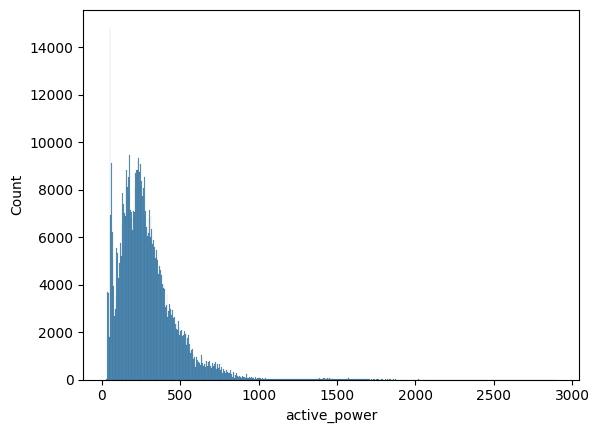

In [12]:
sns.histplot(data=data, x="active_power")
